<a href="https://colab.research.google.com/github/IA-DAMA/MIT-DeepLearning/blob/main/Part2_Music_Generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Copyright Information

In [1]:
# Copyright 2023 MIT Introduction to Deep Learning. All Rights Reserved.
#
# Licensed under the MIT License. You may not use this file except in compliance
# with the License. Use and/or modification of this code outside of MIT Introduction
# to Deep Learning must reference:
#
# © MIT Introduction to Deep Learning
# http://introtodeeplearning.com

# Lab 1: Intro to TensorFlow and Music Generation with RNNs
# Part 2: Music Generation with RNNs

*In this portion of the lab, we will be building a RNN for music generation. As training a model to learn the patterns in raw sheet music in ABC notation and
use this model to generate new music.*


**2.1 Dependencies**

*First, let's download the course repository, install dependencies and import the required packages for this lab.*



In [4]:
# Import Tensorflow 2.0 - PS: It has no effect in Colab because it already includes that
%tensorflow_version 2.x
import tensorflow as tf

# Download and import the MIT Introduction to Deep Learning package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


# 2.2 Dataset

*MIT's dataset of thousands of Irish folk songs represented in the ABC notation*

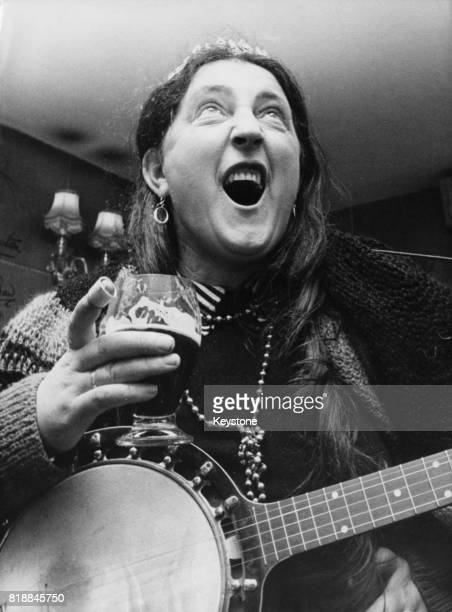

In [5]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


*We can easily convert a song in ABC notation to an audio waveform and play it back. Be patient for this conversion to run, it can take some time.*

In [6]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

*One important thing to think about is that this notation of music does not simply contain information on the notes being played, but additionally there is meta information such as the song title, key, and tempo. How does the number of different characters that are present in the text file impact the complexity of the learning problem? This will become important soon, when we generate a numerical representation for the text data.*

In [7]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


# 2.3 Process the dataset for the learning task

**Vectorize the text**

*Before we begin training our RNN model, we'll need to create a numerical representation of our text-based dataset. To do this, we'll generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters.*

In [8]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d",
#   we can evaluate `char2idx["d"]`.
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

*This gives us an integer representation for each character. Observe that the unique characters (i.e, our vocabulary) in the text are mapped as indices from 0 to  len(unique). Let's take a peek at this numerical representaiton of our dataset:*

In [9]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


# Vectorize the songs string

*Write a function to convert the all songs string to a vectorized*
    *(i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.*

*The output of the `vectorize_string` function
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string*


In [11]:
def vectorize_string(string):
    # Map every char to index according to the dictionary
    vectorized_array = np.array([char2idx[char] for char in string])
    return vectorized_array

# Vetorize a string from music
vectorized_songs = vectorize_string(songs_joined)

*We can also look at how the first part of the text is mapped to an integer representation:*

In [12]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


# Create training examples and targets

*Our next step is to actually divide the text into example sequences that we'll use during training. Each input sequence that we feed into our RNN will contain seq_length characters from the text. We'll also need to define a target sequence for each input sequence, which will be used in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.*

*To do this, we'll break the text into chunks of seq_length+1. Suppose seq_length is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".*

*The batch method will then let us convert this stream of character indices to sequences of the desired size.*

In [13]:
### Batch definition to create training examples ###


def get_batch(vectorized_songs, seq_length, batch_size):
    # the length of the vectorized songs string
    n = vectorized_songs.shape[0] - 1
    # randomly choose the starting indices for the examples in the training batch
    idx = np.random.choice(n-seq_length, batch_size)

    input_batch = [vectorized_songs[i:i + seq_length] for i in idx] # = list of input sequences for the training batch
    output_batch = [vectorized_songs[i + 1:i + seq_length + 1] for i in idx] # = list of output sequences for the training batch

    x_batch = np.reshape(input_batch, [batch_size, seq_length])
    y_batch = np.reshape(output_batch, [batch_size, seq_length])
    return x_batch, y_batch

# Perform some simple tests to ensure batch function is working properly :)
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args):
   print("======\n[FAIL] could not pass tests")
else:
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


*For each of these vectors, each index is processed at a single time step. So, for the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step, i.e., its updated state, in addition to the current input.*

*We can make this concrete by taking a look at how this works over the first several characters in our text:*

In [15]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 8 (',')
  expected output: 14 ('2')
Step   1
  input: 14 ('2')
  expected output: 1 (' ')
Step   2
  input: 1 (' ')
  expected output: 29 ('D')
Step   3
  input: 29 ('D')
  expected output: 30 ('E')
Step   4
  input: 30 ('E')
  expected output: 32 ('G')


# 2.4 The Recurrent Neural Network (RNN) model

*Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.*

*The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected `Dense` layer where we'll output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character.*

*As we introduced in the first portion of this lab, we'll be using the Keras API, specifically, `tf.keras.Sequential`, to define the model. Three layers are used to define the model:*

*`tf.keras.layers.Embedding`: This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with embedding_dim dimensions.*

*`tf.keras.layers.LSTM`: Our LSTM network, with size units=rnn_units.*

*`tf.keras.layers.Dense`: The output layer, with vocab_size outputs.*



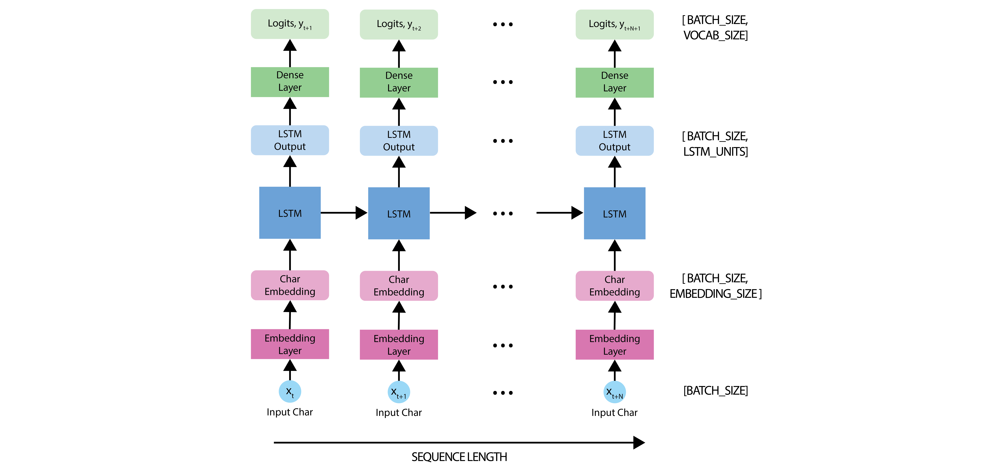

# Define the RNN model

*Defining a function we will use to build the model.*



In [16]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences=True,
      recurrent_initializer='glorot_uniform',
      recurrent_activation='sigmoid',
      stateful=True,
    )

*Defining the RNN model within the build_model function, and then call the function you just defined to instantiate the model!*

In [17]:
# Defining the RNN Model
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
    model = tf.keras.Sequential([
        # Layer 1: Embedding layer to transform indices into dense vectors
        # of a fixed embedding size
        tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

        # Layer 2: LSTM with `rnn_units` number of units.
        LSTM(rnn_units),  # Using the previously defined LSTM function

        # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
        # into the vocabulary size.
        tf.keras.layers.Dense(vocab_size)  # Add the Dense layer
    ])

    return model

# Build a simple model with default hyperparameters. You can change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

# Test out the RNN model

*It's always a good idea to run a few simple checks on our model to see that it behaves as expected. First, we can use the Model.summary function to print out a summary of our model's internal workings. Here we can check the layers in the model, the shape of the output of each of the layers, the batch size, etc.*



In [18]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


*Checking the dimensionality of our output by using a seqquence length (seq_length) of 100. In addition to that, the model can be run on inputs of any length.*

In [20]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


# Predictions from the untrained model

*Let's take a look at what our untrained model is predicting.*

*To get actual predictions from the model, we sample from the output distribution, which is defined by a softmax over our character vocabulary. This will give us actual character indices. This means we are using a categorical distribution to sample over the example prediction. This gives a prediction of the next character (specifically its index) at each timestep.*

*Note here that we sample from this probability distribution, as opposed to simply taking the argmax, which can cause the model to get stuck in a loop.*

*Let's try this sampling out for the first example in the batch.*


In [22]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([51,  4, 29, 33, 44,  7, 59, 28, 53, 17, 54, 46, 55, 80, 74, 68, 53,
       28, 25, 64, 62, 35, 69, 54, 24, 70, 77, 28, 41, 20, 18, 77, 30,  9,
       39, 14, 21, 39, 65, 28, 61, 40, 75, 50, 44, 66,  2, 69, 45, 67, 31,
       30, 18, 22, 61, 21, 40, 65, 61, 51,  9, 57, 24, 41,  0, 22, 14, 76,
       68, 30,  1, 70, 31, 25, 65, 70, 46, 36, 53,  8, 29, 54, 71, 30, 46,
        1, 21,  1,  7, 72, 69, 80, 12, 50,  5, 67,  7, 51, 17, 26])

*We can now decode these to see the text predicted by the untrained model:*



In [23]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 ' dcA|BdB cAF|AGF G2:|!\nB|d3 gdB|d3 gdB|cBc AGA|=fef ABc|!\nd3 gdB|d3 gdc|BdB cAF|AGF G2:|!\n\nX:126\nT:R'

Next Char Predictions: 
 "Z#DHS)dC]5^U_ysm]C>igJn^=ovCP86vE-N29NjCfOtYSk!nTlFE6:f9OjfZ-b=P\n:2umE oF>joUK],D^pEU 9 )qny0Y'l)Z5A"


*The text predicted by the untrained model is just nonsense so that we can train our network!*



# 2.5 Training the model: loss and training operations

**Now it's time to train the model!**

*At this point, we can think of our next character prediction problem as a standard classification problem. Given the previous state of the RNN, as well as the input at a given time step, we want to predict the class of the next character -- that is, to actually predict the next character.*

*To train our model on this classification task, we can use a form of the `crossentropy` loss (negative log likelihood loss). Specifically, we will use the `sparse_categorical_crossentropy` loss, as it utilizes integer targets for categorical classification tasks. We will want to compute the loss using the true targets -- the `labels` -- and the predicted targets -- the `logits`.*

*Let's first compute the loss using our example predictions from the untrained model:*

In [24]:
### Defining the loss function ###

def compute_loss(labels, logits):
    loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
    return loss
# Compute the loss using the true next characters from the example batch
# and the predictions from the untrained model

    example_batch_loss = compute_loss(y, pred)
    print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
    print("scalar_loss:      ", example_batch_loss.numpy().mean())

*Let's start by defining some hyperparameters for training the model. To start, we have provided some reasonable values for some of the parameters. It is up to you to use what we've learned in class to help optimize the parameter selection here!*

In [25]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 3000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters:
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

*Now, we are ready to define our training operation -- the optimizer and duration of training -- and use this function to train the model. You will experiment with the choice of optimizer and the duration for which you train your models, and see how these changes affect the network's output. Some optimizers you may like to try are Adam and Adagrad.*

*First, we will instantiate a new model and an optimizer. Then, we will use the tf.GradientTape method to perform the backpropagation operations.*

*We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss.*

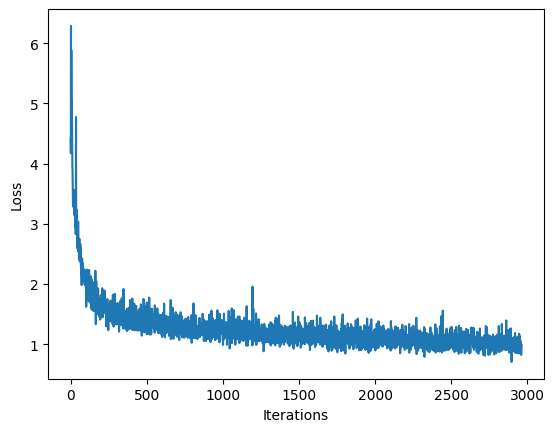

100%|██████████| 3000/3000 [01:30<00:00, 33.29it/s]


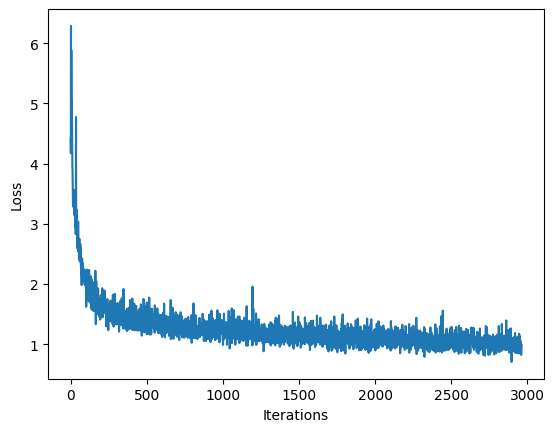

In [26]:
### Define optimizer and training operation ###

# Instantiate a new model for training
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

# Instantiate an optimizer (using Adam optimizer)
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

# Training step function
@tf.function
def train_step(x, y):
# Use tf.GradientTape()
    with tf.GradientTape() as tape:
        y_hat = model(x)    # feeding the current input into the model and generate predictions
        loss = compute_loss(y, y_hat)     # computing the loss

# Now, compute the gradients
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

# Save the trained model and the weights
model.save_weights(checkpoint_prefix)

# 2.6 Generate music using the RNN model

*Now, we can use our trained RNN model to generate some music! When generating music, we'll have to feed the model some sort of seed to get it started (because it can't predict anything without something to start with!).*

*Once we have a generated seed, we can then iteratively predict each successive character (remember, we are using the ABC representation for our music) using our trained RNN. More specifically, recall that our RNN outputs a `softmax` over possible successive characters. For inference, we iteratively sample from these distributions, and then use our samples to encode a generated song in the ABC format.*

*Then, all we have to do is write it to a file and listen!*

In [27]:
# Rebuild the model using batch_size=1
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights from the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

# Print model summary
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_2 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_2 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


*Notice that we have fed in a fixed `batch_size` of 1 for inference.*

# The prediction procedure

Now, we're ready to write the code to generate text in the ABC music format:



*   Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

*   Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

*   Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

*   At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.




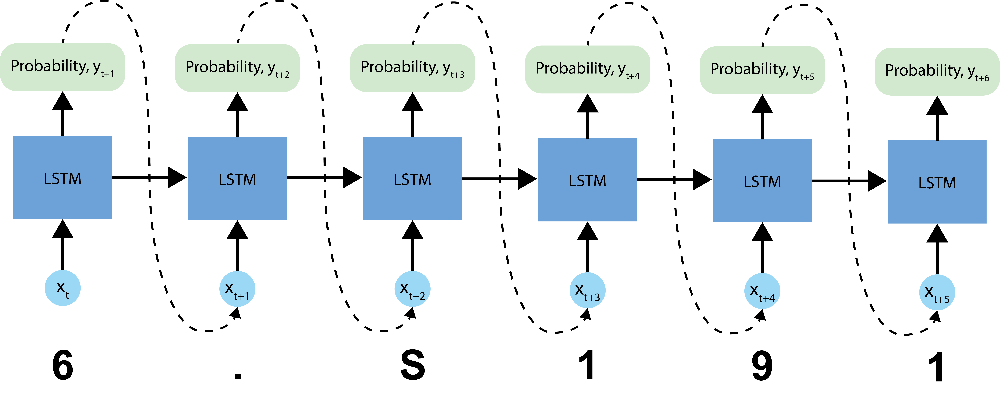




In [28]:
# Prediction of a generated song
def generate_text(model, start_string, generation_length=1000):
    # Evaluation step (generating ABC text using the learned RNN model)

    # Convert the start string to numbers (vectorize)
    input_eval = [char2idx[s] for s in start_string]
    input_eval = tf.expand_dims(input_eval, 0)

    # Empty string to store the generated results
    text_generated = []

    # Here batch size == 1
    model.reset_states()
    tqdm._instances.clear()

    for _ in tqdm(range(generation_length)):
        # Evaluate the inputs and generate the next character predictions
        predictions = model(input_eval)

        # Remove the batch dimension
        predictions = tf.squeeze(predictions, 0)

        # Use a multinomial distribution to sample
        predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

        # Pass the prediction along with the previous hidden state
        # as the next inputs to the model
        input_eval = tf.expand_dims([predicted_id], 0)

        # Add the predicted character to the generated text
        text_generated.append(idx2char[predicted_id])

    return (start_string + ''.join(text_generated))

# Generate a text using the trained model

In [29]:
generated_text = generate_text(model, start_string="X:", generation_length=1000)
print(generated_text)

100%|██████████| 1000/1000 [00:10<00:00, 98.56it/s] 

X:25
T:Rackore Wats
Z: id:dc-slipjig-20
M:9/8
L:1/8
K:G Major
E|A2FA DAFA|BFAF EFGB|AFF2 DEFA|defg afdf|gedB eAA2:|!

X:344
T:Sand of OudAFE|D2FA DAFA|Beed efgb|afdf e2fg|!
agfa gfdf|eggf edBA|G2AF G2Bc|d3d gfgd|BdAF G3:|!
[2 B2|G2BG DGBd|e2EC DFAF|AF^FA d3e|fgec d3A|!
AFAc dcBA|GABG AGEG|cdef gedB|!
dgg2 agef|g2gf gabg|g2af gega|!
bage dgea|gedA GAed|cADE GABd|eggf g2ga|!
bgag egdg|bgaf efge|]!
f2ae fece|defg afdf|ecB2 agef|gdB G2|]!

X:354
T:Rassess
Z: id:dc-reel-313
M:C
L:1/8
K:A Major
B|A2dB A2gB|A2FA BdAF|D2ED C3F|EGcG EGcG|c|D3 EDD:|!

X:170
T:Re efged eged|cABG AGED|!
E2EA GB|ADD2 ADFA|AFGA Bdef|g2fg e3:199
K:D Dorian
gf|eAAG A2Bd|egdg edBd|eBB2 gedB|FAA2 f3g|a2gf edB:|!
f|edcB AFEF|DFAF DFDF|GFEF GFGA|B A2:|!

X:202
T:Old Bgg|dgbg ageg|ffdf e3d|!
Bee2 e3g|eaa2 B3B|c2E2 D4|]!

X:346
T:Waddy Dakiy Kelly's No. 1
Z: id:dc-reel-289
M:C
L:1/8
K:E Dorian
EA|BEE2 BAFA|BAFA dAcA|B3A d3e|fece faef|!
Beee deAA|B2BG AGEF|GFEF GABG|ABAG CECE|!
D2FD ADFD|A3B defg|affd aeef|edef gedB|!
GEED D

## Play back the generated music!

*We can now call a function to convert the ABC format text to an audio file, and then play that back to check out our generated music! Try training longer if the resulting song is not long enough, or re-generating the song!*

In [30]:
### Playing back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it!
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 5 songs in text
Generated song 0


Generated song 2


Generated song 3


https://github.com/aamini/introtodeeplearning/blob/master/lab1/Part2_Music_Generation.ipynb

Check such repository and classes on Youtube - MIT (Deep Learning Course)